<a href="https://colab.research.google.com/github/SCP-hayashi/Traffic-Detection/blob/main/Traffic_counting_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Preparation

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
! mkdir /content/vehicle_counting_tensorflow
! cp /content/drive/MyDrive/0417入手/* /content/vehicle_counting_tensorflow

mkdir: cannot create directory ‘/content/vehicle_counting_tensorflow’: File exists


In [4]:
% cd /content/vehicle_counting_tensorflow

/content/vehicle_counting_tensorflow


In [5]:
VIDEO_SOURCE = "/content/vehicle_counting_tensorflow/test2.mp4"

# Import

In [6]:
# import needed modules
!pip install sk-video>=1.1.8
import os
import csv
import numpy as np
import logging
import logging.handlers
import math
import sys
import random
import numpy as np
import skvideo.io
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

from IPython.display import HTML
from base64 import b64encode

# without this some strange errors happen
cv2.ocl.setUseOpenCL(False)
random.seed(123)

# setup logging
def init_logging(level=logging.INFO):
    main_logger = logging.getLogger()
    for hnd in main_logger.handlers:
        main_logger.removeHandler(hnd)

    formatter = logging.Formatter(
        fmt='%(asctime)s.%(msecs)03d %(levelname)-8s [%(name)s] %(message)s', datefmt='%Y-%m-%d %H:%M:%S')

    handler_stream = logging.StreamHandler(sys.stdout)
    handler_stream.setFormatter(formatter)
    main_logger.addHandler(handler_stream)
    main_logger.setLevel(level)

    return main_logger

# Helper function

In [7]:
def train_bg_subtractor(inst, cap, num=500):
    '''
        BG substractor need process some amount of frames to start giving result
    '''
    print ('Training BG Subtractor...')
    i = 0
    for frame in cap:
        inst.apply(frame, None, 0.001)
        i += 1
        if i >= num:
            return cap

# # VIDEO_SOURCE = "/content/vehicle_counting_tensorflow/test2.mp4"

# bg_subtractor = cv2.createBackgroundSubtractorMOG2(
#         history=500, detectShadows=True)

# # Set up image source
# cap = skvideo.io.vreader(VIDEO_SOURCE)

# # skipping 500 frames to train bg subtractor
# train_bg_subtractor(bg_subtractor, cap, num=500)

# frame = next(cap)
# fg_mask = bg_subtractor.apply(frame, None, 0.001)

# plt.figure(figsize=(12,12))
# plt.imshow(fg_mask)
# plt.show()

In [8]:
def get_centroid(x, y, w, h):
    x1 = int(w / 2)
    y1 = int(h / 2)

    cx = x + x1
    cy = y + y1

    return (cx, cy)

In [9]:
import matplotlib.patches as patches
def save_frame(frame, file_name, flip=True):
    print('saving frame', file_name)
    # flip BGR to RGB
    if flip:
        cv2.imwrite(file_name, np.flip(frame, 2))
    else:
        cv2.imwrite(file_name, frame)

In [10]:
def distance(x, y, type='euclidian', x_weight=1.0, y_weight=1.0):
    if type == 'euclidian':
        return math.sqrt(float((x[0] - y[0])**2) / x_weight + float((x[1] - y[1])**2) / y_weight)

# Classes

## PipelineRunner

In [11]:
class PipelineRunner(object):
    '''
        Very simple pipline.

        Just run passed processors in order with passing context from one to 
        another.

        You can also set log level for processors.
    '''

    def __init__(self, pipeline=None, log_level=logging.INFO):
        self.pipeline = pipeline or []
        self.context = {}
        self.log = logging.getLogger(self.__class__.__name__)
        self.log.setLevel(log_level)
        self.log_level = log_level
        self.set_log_level()

    def set_context(self, data):
        self.context = data

    def add(self, processor):
        if not isinstance(processor, PipelineProcessor):
            raise Exception(
                'Processor should be an isinstance of PipelineProcessor.')
        processor.log.setLevel(self.log_level)
        self.pipeline.append(processor)

    def remove(self, name):
        for i, p in enumerate(self.pipeline):
            if p.__class__.__name__ == name:
                del self.pipeline[i]
                return True
        return False

    def set_log_level(self):
        for p in self.pipeline:
            p.log.setLevel(self.log_level)

    def run(self):
        for p in self.pipeline:
            self.context = p(self.context)

        self.log.debug("Frame #%d processed.", self.context['frame_number'])

        return self.context


class PipelineProcessor(object):
    '''
        Base class for processors.
    '''

    def __init__(self):
        self.log = logging.getLogger(self.__class__.__name__)

## ContourDetection

In [12]:
class ContourDetection(PipelineProcessor):
    '''
        Detecting moving objects.

        Purpose of this processor is to subtrac background, get moving objects
        and detect them with a cv2.findContours method, and then filter off-by
        width and height. 

        bg_subtractor - background subtractor isinstance.
        min_contour_width - min bounding rectangle width.
        min_contour_height - min bounding rectangle height.
        save_image - if True will save detected objects mask to file.
        image_dir - where to save images(must exist).        
    '''

    def __init__(self, bg_subtractor, min_contour_width=35, min_contour_height=35, save_image=False, image_dir='images'):
        super(ContourDetection, self).__init__()

        self.bg_subtractor = bg_subtractor
        self.min_contour_width = min_contour_width
        self.min_contour_height = min_contour_height
        self.save_image = save_image
        self.image_dir = image_dir

    def filter_mask(self, img, a=None):
        '''
            This filters are hand-picked just based on visual tests
        '''

        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (2, 2))

        # Fill any small holes
        closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
        # Remove noise
        opening = cv2.morphologyEx(closing, cv2.MORPH_OPEN, kernel)

        # Dilate to merge adjacent blobs
        dilation = cv2.dilate(opening, kernel, iterations=2)

        return dilation

    def bb_intersection_over_union(self, boxA, boxB):
        
        # determine the (x, y)-coordinates of the intersection rectangle
        xA = max(boxA[0], boxB[0])
        yA = max(boxA[1], boxB[1])
        xB = min(boxA[2], boxB[2])
        yB = min(boxA[3], boxB[3])
        # compute the area of intersection rectangle
        interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
        # compute the area of both the prediction and ground-truth
        # rectangles
        boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
        boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
        # compute the intersection over union by taking the intersection
        # area and dividing it by the sum of prediction + ground-truth
        # areas - the interesection area
        if float(boxAArea + boxBArea - interArea) == 0:
          return 1
        iou = interArea / float(boxAArea + boxBArea - interArea)
        print(boxA, boxB, iou)
        # return the intersection over union value
        return iou

    def is_bb_valid(self, box, matches, num_rv_result):
      for i in range(num_rv_result):
          m, _ = matches[i]
          x = m[0]
          y = m[1]
          w = m[2]
          h = m[3]

          if self.bb_intersection_over_union(box, [x, y, x+w, y+h]) > 0.10:
            return False

      return True

    def detect_vehicles(self, fg_mask, context):

        matches = []

        # finding external contours
        contours, hierarchy = cv2.findContours(
            fg_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_TC89_L1)
        
        # fig, ax = plt.subplots(2)
        # ax[0].imshow(fg_mask)
        # ax[1].imshow(frame)
        # plt.show()

        # fig, ax = plt.subplots()
        # tmp = fg_mask.copy()

        for (i, contour) in enumerate(contours):
            (x, y, w, h) = cv2.boundingRect(contour)
            contour_valid = (w >= self.min_contour_width) and (
                h >= self.min_contour_height)

            if not contour_valid: 
                continue


            # cv2.rectangle(tmp,(x,y),(x+w,y+h),(255,0,0),3)
            

            centroid = get_centroid(x, y, w, h)

            matches.append(((x, y, w, h), centroid))
        # plt.imshow(tmp)
        # plt.show()
        return matches

    def __call__(self, context):
        frame = context['frame'].copy()
        frame_number = context['frame_number']

        fg_mask = self.bg_subtractor.apply(frame, None, 0.001)
        # just thresholding values
        fg_mask[fg_mask < 240] = 0
        # print('mask')
        fg_mask = self.filter_mask(fg_mask, frame_number)
        if self.save_image:
            save_frame(fg_mask, self.image_dir +
                             "/mask_%04d.png" % frame_number, flip=False)

        context['objects'] = self.detect_vehicles(fg_mask, context)
        context['fg_mask'] = fg_mask

        return context


## VehicleCounter

In [40]:
class VehicleCounter(PipelineProcessor):
    '''
        Counting vehicles that entered in exit zone.

        Purpose of this class based on detected object and local cache create
        objects pathes and count that entered in exit zone defined by exit masks.

        exit_masks - list of the exit masks.
        path_size - max number of points in a path.
        max_dst - max distance between two points.
    '''

    def __init__(self, exit_masks=[], path_size=10, max_dst=30, x_weight=1.0, y_weight=1.0):
        super(VehicleCounter, self).__init__()

        self.exit_masks = exit_masks

        self.vehicle_count = 0
        self.path_size = path_size
        self.pathes = []
        self.max_dst = max_dst
        self.x_weight = x_weight
        self.y_weight = y_weight

    def check_exit(self, point):
        for exit_mask in self.exit_masks:
            try:
                if exit_mask[point[1]][point[0]] == 255:
                    return True
            except:
                return True
        return False

    def __call__(self, context):
        objects = context['objects']
        context['exit_masks'] = self.exit_masks
        context['pathes'] = self.pathes
        context['vehicle_count'] = self.vehicle_count
        if not objects:
            return context

        points = np.array(objects)[:, 0:2]
        points = points.tolist()

        # add new points if pathes is empty
        if not self.pathes:
            for match in points:
                self.pathes.append([match])

        else:
            # link new points with old pathes based on minimum distance between
            # points
            new_pathes = []

            for path in self.pathes:
                _min = 999999
                _match = None
                for p in points:
                    if len(path) == 1:
                        # distance from last point to current
                        d = distance(p[0], path[-1][0])
                    else:
                        # based on 2 prev points predict next point and calculate
                        # distance from predicted next point to current
                        xn = 2 * path[-1][0][0] - path[-2][0][0]
                        yn = 2 * path[-1][0][1] - path[-2][0][1]
                        d = distance(
                            p[0], (xn, yn),
                            x_weight=self.x_weight,
                            y_weight=self.y_weight
                        )

                    if d < _min:
                        _min = d
                        _match = p

                if _match and _min <= self.max_dst:
                    points.remove(_match)
                    path.append(_match)
                    new_pathes.append(path)

                # do not drop path if current frame has no matches
                if _match is None:
                    new_pathes.append(path)

            self.pathes = new_pathes

            # add new pathes
            if len(points):
                for p in points:
                    # do not add points that already should be counted
                    if self.check_exit(p[1]):
                        continue
                    self.pathes.append([p])

        # save only last N points in path
        for i, _ in enumerate(self.pathes):
            self.pathes[i] = self.pathes[i][self.path_size * -1:]

        # count vehicles and drop counted pathes:
        new_pathes = []
        for i, path in enumerate(self.pathes):
            d = path[-2:]

            if (
                # need at list two points to count
                len(d) >= 2 and
                # prev point not in exit zone
                not self.check_exit(d[0][1]) and
                # current point in exit zone
                self.check_exit(d[1][1]) and
                # path len is bigger then min
                self.path_size <= len(path)
            ):
                self.vehicle_count += 1
                x, y, w, h = d[1][0]
                #TODO
                if d[1][1][0] - d[0][1][0] < 0:
                  direction = 'left'
                else:
                  direction = 'right'
                frame = context['frame']
                l = int(x)
                r = int(x+w)
                t = int(y)
                b = int(y+h)

                id_ = len(os.listdir('/content/drive/MyDrive/Ikata/rekognition-video/cropped/'+VIDEO_SOURCE.split('.')[0]+'/'))
                print('id_', id_)
                save_frame(frame[t:b, l:r], '/content/drive/MyDrive/Ikata/rekognition-video/cropped/'+VIDEO_SOURCE.split('.')[0]+'/'+str(id_)+'_'+direction+'.png')
            else:
                # prevent linking with path that already in exit zone
                add = True
                for p in path:
                    if self.check_exit(p[1]):
                        add = False
                        break
                if add:
                    new_pathes.append(path)

        self.pathes = new_pathes

        context['pathes'] = self.pathes
        context['objects'] = objects
        context['vehicle_count'] = self.vehicle_count

        self.log.debug('#VEHICLES FOUND: %s' % self.vehicle_count)

        return context

## CSVWriter

In [41]:
class CsvWriter(PipelineProcessor):

    def __init__(self, path, name, start_time=0, fps=15):
        super(CsvWriter, self).__init__()

        self.fp = open(os.path.join(path, name), 'w')
        self.writer = csv.DictWriter(self.fp, fieldnames=['frame number', 'vehicles'])
        self.writer.writeheader()
        self.start_time = start_time
        self.fps = fps
        self.path = path
        self.name = name
        self.prev = None

    def __call__(self, context):
        frame_number = context['frame_number']
        count = _count = context['vehicle_count']

        if self.prev:
            _count = count - self.prev

        # time = ((self.start_time + int(frame_number / self.fps)) * 100 
                # + int(100.0 / self.fps) * (frame_number % self.fps))

        self.writer.writerow({'frame number': frame_number, 'vehicles': _count})
        self.prev = count

        return context

## Visualizer

In [42]:
BOUNDING_BOX_COLOUR = (255, 192, 0)
CENTROID_COLOUR = (255, 192, 0)
CAR_COLOURS = [(255, 192, 0)]
EXIT_COLOR = (66, 183, 42)

class Visualizer(PipelineProcessor):

    def __init__(self, save_image=True, image_dir='images'):
        super(Visualizer, self).__init__()

        self.save_image = save_image
        self.image_dir = image_dir

    def check_exit(self, point, exit_masks=[]):
        for exit_mask in exit_masks:
            if exit_mask[point[1]][point[0]] == 255:
                return True
        return False

    def draw_pathes(self, img, pathes):
        if not img.any():
            return

        for i, path in enumerate(pathes):
            path = np.array(path)[:, 1].tolist()
            for point in path:
                cv2.circle(img, point, 2, CAR_COLOURS[0], -1)
                cv2.polylines(img, [np.int32(path)], False, CAR_COLOURS[0], 1)

        return img

    def draw_boxes(self, img, pathes, exit_masks=[]):
        for (i, match) in enumerate(pathes):

            contour, centroid = match[-1][:2]
            if self.check_exit(centroid, exit_masks):
                continue

            x, y, w, h = contour

            cv2.rectangle(img, (x, y), (x + w - 1, y + h - 1),
                          BOUNDING_BOX_COLOUR, 1)
            cv2.circle(img, centroid, 2, CENTROID_COLOUR, -1)

        return img

    def draw_ui(self, img, vehicle_count, exit_masks=[]):

        # this just add green mask with opacity to the image
        for exit_mask in exit_masks:
            _img = np.zeros(img.shape, img.dtype)
            _img[:, :] = EXIT_COLOR
            mask = cv2.bitwise_and(_img, _img, mask=exit_mask)
            cv2.addWeighted(mask, 1, img, 1, 0, img)

        # drawing top block with counts
        cv2.rectangle(img, (0, 0), (img.shape[1], 50), (0, 0, 0), cv2.FILLED)
        cv2.putText(img, ("Vehicles passed: {total} ".format(total=vehicle_count)), (30, 30),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 255, 255), 1)
        return img

    def __call__(self, context):
        frame = context['frame'].copy()
        frame = np.ascontiguousarray(np.flip(frame, 2))
        frame_number = context['frame_number']
        pathes = context['pathes']
        exit_masks = context['exit_masks']
        vehicle_count = context['vehicle_count']

        frame = self.draw_ui(frame, vehicle_count, exit_masks)
        frame = self.draw_pathes(frame, pathes)
        frame = self.draw_boxes(frame, pathes, exit_masks)
        if self.save_image:
            save_frame(frame, self.image_dir +
                            "/processed_%04d.png" % frame_number)

        context['frame'] = frame
        return context

## Main

In [43]:
# build runner
def main():
    log = logging.getLogger("main")

    # creating exit mask from points, where we will be counting our vehicles
    base = np.zeros(SHAPE + (3,), dtype='uint8')
    exit_mask = cv2.fillPoly(base, EXIT_PTS, (255, 255, 255))[:, :, 0]

    # there is also bgslibrary, that seems to give better BG substruction, but
    # not tested it yet
    bg_subtractor = cv2.createBackgroundSubtractorMOG2(
        history=500, detectShadows=True)

    # processing pipline for programming conviniance
    pipeline = PipelineRunner(pipeline=[
        ContourDetection(bg_subtractor=bg_subtractor,
                         save_image=True, image_dir=IMAGE_DIR),
        # we use y_weight == 2.0 because traffic are moving vertically on video
        # use x_weight == 2.0 for horizontal.
        VehicleCounter(exit_masks=[exit_mask], y_weight=2.0),
        Visualizer(image_dir=IMAGE_DIR,save_image=True),
        CsvWriter(path='./', name='/content/drive/MyDrive/Ikata/rekognition-video/'+VIDEO_SOURCE.split('.')[0] + '.csv')
    ], log_level=logging.INFO)

    # Set up image source
    cap = skvideo.io.vreader(VIDEO_SOURCE)

    # skipping 500 frames to train bg subtractor
    train_bg_subtractor(bg_subtractor, cap, num=500)

    fourcc = cv2.VideoWriter_fourcc(*"MP4V")
    writer = cv2.VideoWriter(VIDEO_OUT, fourcc, 25, (SHAPE[1], SHAPE[0]), True)
    print(VIDEO_OUT)
    frame_number = -1
    for frame in cap:
        print(frame.shape)
        if not frame.any():
            log.error("Frame capture failed, stopping...")
            break

        frame_number += 1
        log.info("Frame #%s" % frame_number)

        pipeline.set_context({
            'frame': frame,
            'frame_number': frame_number,
        })
        ctx = pipeline.run()
        writer.write(ctx['frame'])
        # cv2_imshow(ctx['frame'])
        if frame_number > PARSE_FRAMES:
            break
    writer.release()

# Run

In [44]:
! rm /content/drive/MyDrive/Ikata/rekognition-video/cropped/006_220415073137_0907_anti/*

rm: cannot remove '/content/drive/MyDrive/Ikata/rekognition-video/cropped/006_220415073137_0907_anti/*': No such file or directory


In [45]:
# ! rm /content/drive/MyDrive/Ikata/rekognition-video/cropped/006_220415073137_0907/*

In [46]:
! rm /content/drive/MyDrive/Ikata/rekognition-video/006_220415073137_0907_anti_2_parsed.mp4

rm: cannot remove '/content/drive/MyDrive/Ikata/rekognition-video/006_220415073137_0907_anti_2_parsed.mp4': No such file or directory


In [47]:
# Parameters
# sources = ["020_220415073137_0907.mp4", "001_220415073137_1407.mp4", "006_220415073137_0907.mp4", "019_220415073137_0907.mp4"]
sources = ['test2.mp4', '020_220415073137_0907.mp4', '006_220415073137_0907_anti.mp4']

greens  = [np.array([
    # test2.mp4
    [[550, 720], [550, 700], [1280, 700], [1280, 720]],
    [[650, 570], [650, 550], [1280, 550], [1280, 570]],
    [[350, 630], [350, 610], [590, 610], [590, 630]],
    [[400, 510], [400, 490], [700, 490], [700, 510]],
  
    # test.mp4
    # [[300, 720], [300, 520], [1280, 520], [1280, 720]],
    # [[0, 300], [600, 300], [600, 0], [0, 0]]


]), 
np.array([
      [[0, 360], [0, 0], [20, 0], [20, 360]],
      [[180, 360], [180, 0], [200, 0], [200, 360]],
      [[350, 360], [350, 0], [370, 0], [370, 360]],
]),
np.array([
    [[0, 200], [150, 200], [150, 360], [0, 360]],
    [[250, 200], [250, 360],  [400, 360], [400, 200]],
    [[500, 200], [500, 360], [650, 360], [650, 200]],
])
]

shapes = [
  (720, 1280),
  (360, 640),
  (360, 640)
]

PARSE_FRAMES = 250*250
# PARSE_FRAMES = 100

for i, VIDEO_SOURCE in enumerate(sources):
  if i != 2:
    continue
  # ============================================================================
  IMAGE_DIR = "./out"
  VIDEO_OUT = './'+VIDEO_SOURCE.split('.')[0]+'_'+str(i)+'_parsed.mp4'
  # VIDEO_OUT = '/content/drive/MyDrive/Ikata/rekognition-video/'+VIDEO_SOURCE.split('.')[0]+'_'+str(i)+'_parsed.mp4'
  SHAPE = shapes[i]# HxW
  EXIT_PTS = greens[i]
  # ============================================================================

  log = init_logging()
  main()

Training BG Subtractor...
./006_220415073137_0907_anti_2_parsed.mp4
(360, 640, 3)
2022-06-15 01:04:12.445 INFO     [main] Frame #0
saving frame ./out/mask_0000.png
saving frame ./out/processed_0000.png
(360, 640, 3)
2022-06-15 01:04:12.478 INFO     [main] Frame #1
saving frame ./out/mask_0001.png
saving frame ./out/processed_0001.png
(360, 640, 3)
2022-06-15 01:04:12.511 INFO     [main] Frame #2
saving frame ./out/mask_0002.png
saving frame ./out/processed_0002.png
(360, 640, 3)
2022-06-15 01:04:12.543 INFO     [main] Frame #3
saving frame ./out/mask_0003.png
saving frame ./out/processed_0003.png
(360, 640, 3)
2022-06-15 01:04:12.581 INFO     [main] Frame #4
saving frame ./out/mask_0004.png
saving frame ./out/processed_0004.png
(360, 640, 3)
2022-06-15 01:04:12.612 INFO     [main] Frame #5
saving frame ./out/mask_0005.png
saving frame ./out/processed_0005.png
(360, 640, 3)
2022-06-15 01:04:12.647 INFO     [main] Frame #6
saving frame ./out/mask_0006.png
saving frame ./out/processed_000

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:42: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:25: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


ストリーミング出力は最後の 5000 行に切り捨てられました。
(360, 640, 3)
2022-06-15 01:13:41.396 INFO     [main] Frame #14661
saving frame ./out/mask_14661.png
saving frame ./out/processed_14661.png
(360, 640, 3)
2022-06-15 01:13:41.434 INFO     [main] Frame #14662
saving frame ./out/mask_14662.png
saving frame ./out/processed_14662.png
(360, 640, 3)
2022-06-15 01:13:41.479 INFO     [main] Frame #14663
saving frame ./out/mask_14663.png
saving frame ./out/processed_14663.png
(360, 640, 3)
2022-06-15 01:13:41.519 INFO     [main] Frame #14664
saving frame ./out/mask_14664.png
saving frame ./out/processed_14664.png
(360, 640, 3)
2022-06-15 01:13:41.563 INFO     [main] Frame #14665
saving frame ./out/mask_14665.png
saving frame ./out/processed_14665.png
(360, 640, 3)
2022-06-15 01:13:41.602 INFO     [main] Frame #14666
saving frame ./out/mask_14666.png
saving frame ./out/processed_14666.png
(360, 640, 3)
2022-06-15 01:13:41.640 INFO     [main] Frame #14667
saving frame ./out/mask_14667.png
saving frame ./out/processe

In [48]:
from google.colab import files
files.download(VIDEO_OUT) 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [29]:
VIDEO_OUT

'./006_220415073137_0907_anti_2_parsed.mp4'

# Test


## Box

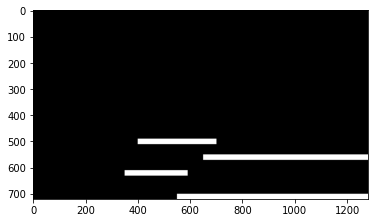

<generator object vreader at 0x7fca4b73df50>


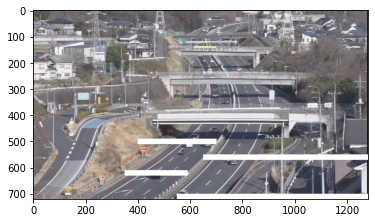

In [164]:
EXIT_PTS = np.array([
    # test2.mp4
    [[550, 720], [550, 700], [1280, 700], [1280, 720]],
    [[650, 570], [650, 550], [1280, 550], [1280, 570]],
    [[350, 630], [350, 610], [590, 610], [590, 630]],
    [[400, 510], [400, 490], [700, 490], [700, 510]],
])

SHAPE = (720,1280)
base = np.zeros(SHAPE + (3,), dtype='uint8')
exit_mask = cv2.fillPoly(base, EXIT_PTS, (255, 255, 255))[:, :, 0]

plt.imshow(base)
plt.show()

cap = skvideo.io.vreader('/content/vehicle_counting_tensorflow/006_220415073137_0907_anti.mp4')
print(cap)
for frame in cap:
  break
background = frame
overlay = np.stack([exit_mask,exit_mask,exit_mask], axis=2)
added_image = cv2.add(background,overlay)
plt.imshow(added_image)

In [30]:
! cp /content/drive/MyDrive/Ikata/rekognition-video/006_220415073137_0907_anti.mp4 /content/vehicle_counting_tensorflow/

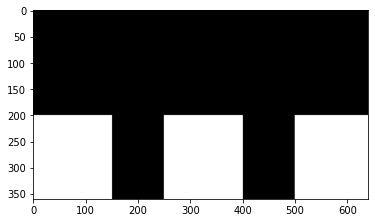

<generator object vreader at 0x7fca4b73dad0>


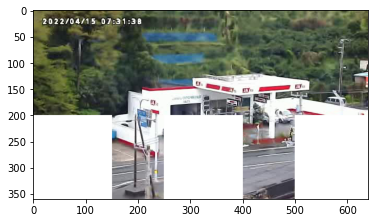

In [155]:
EXIT_PTS = np.array([
    [[0, 200], [150, 200], [150, 360], [0, 360]],
    [[250, 200], [250, 360],  [400, 360], [400, 200]],
    [[500, 200], [500, 360], [650, 360], [650, 200]],
])

SHAPE = (360, 640)
base = np.zeros(SHAPE + (3,), dtype='uint8')
exit_mask = cv2.fillPoly(base, EXIT_PTS, (255, 255, 255))[:, :, 0]

plt.imshow(base)
plt.show()

cap = skvideo.io.vreader('/content/vehicle_counting_tensorflow/006_220415073137_0907_anti.mp4')
print(cap)
for frame in cap:
  break
background = frame
overlay = np.stack([exit_mask,exit_mask,exit_mask], axis=2)
added_image = cv2.add(background,overlay)
plt.imshow(added_image)


In [144]:
! pip3 install ffmpeg
import skvideo.io

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


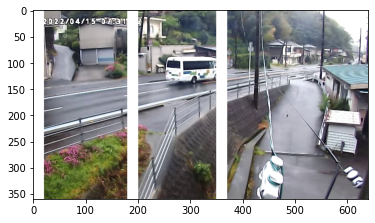

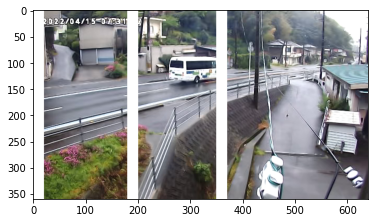

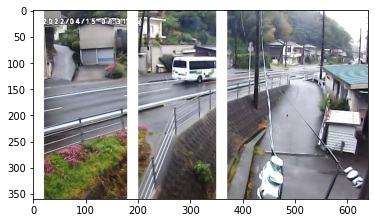

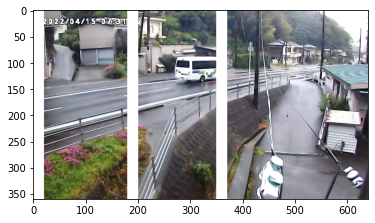

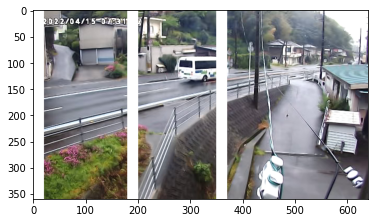

...

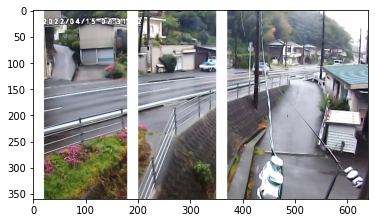

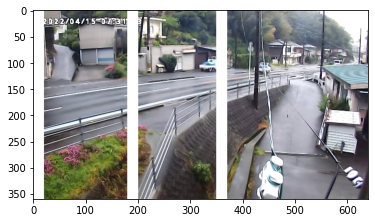

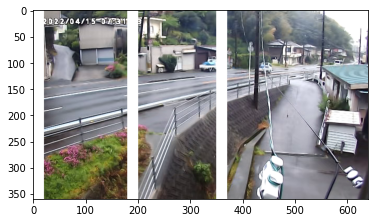

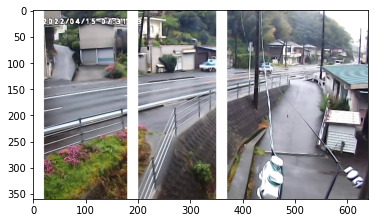

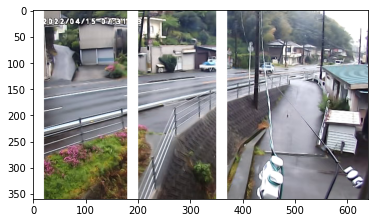

KeyboardInterrupt: ignored

In [60]:
rdr2 = skvideo.io.vreader('/content/vehicle_counting_tensorflow/020_220415073137_0907.mp4')

for img in rdr2:
  overlay = np.stack([exit_mask,exit_mask,exit_mask], axis=2)
  added_image = cv2.add(img,overlay)
  plt.imshow(added_image)
  plt.show()

# Background Subtractor

In [169]:
cap = skvideo.io.vreader('/content/vehicle_counting_tensorflow/test2.mp4')
bg_subtractor = cv2.createBackgroundSubtractorMOG2(history=500, detectShadows=True)
train_bg_subtractor(bg_subtractor, cap, num=500)
fg_mask = bg_subtractor.apply(frame, None, 0.001)

Training BG Subtractor...


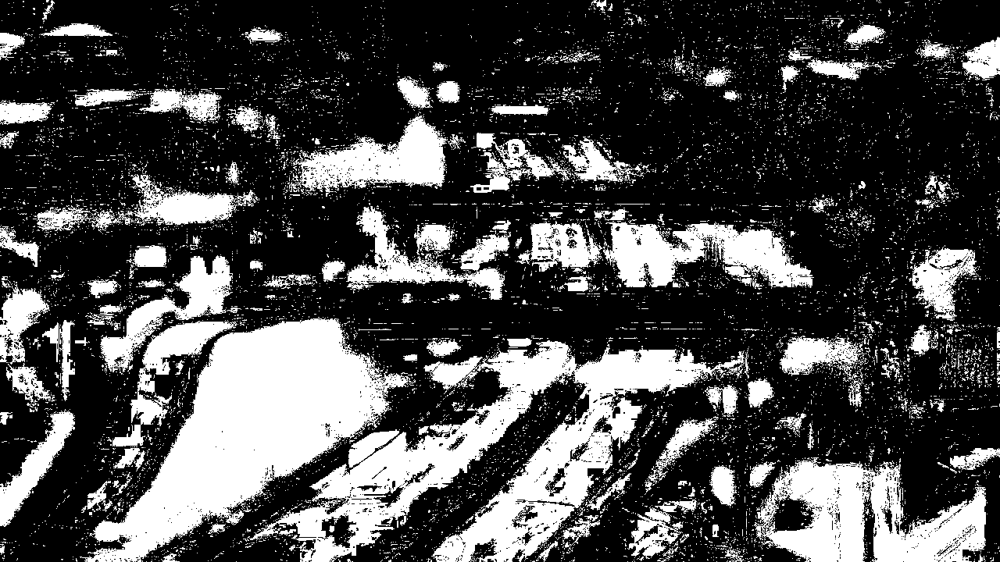

In [177]:
# just thresholding values
image = fg_mask.copy()
image[fg_mask < 255] = 0
cv2_imshow(image)

In [178]:
np.unique(image)

array([  0, 255], dtype=uint8)

# Median Estimation

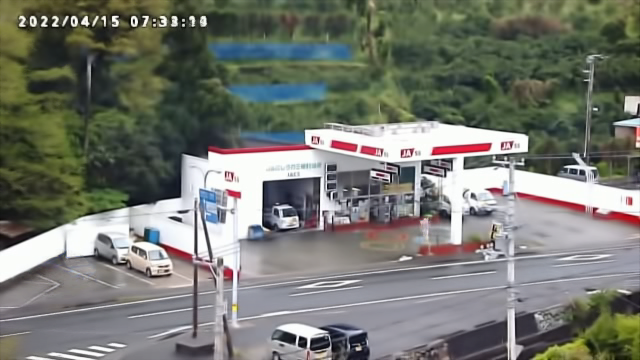

In [184]:
from google.colab.patches import cv2_imshow
import numpy as np
import cv2
from skimage import data, filters

cap = cv2.VideoCapture('006_220415073137_0907_anti.mp4')

frameIds = cap.get(cv2.CAP_PROP_FRAME_COUNT) * np.random.uniform(size=25)

frames = []
for fid in frameIds:
    cap.set(cv2.CAP_PROP_POS_FRAMES, fid)
    ret, frame = cap.read()
    frames.append(frame)
medianFrame = np.median(frames, axis=0).astype(dtype=np.uint8) 

cv2_imshow(medianFrame)

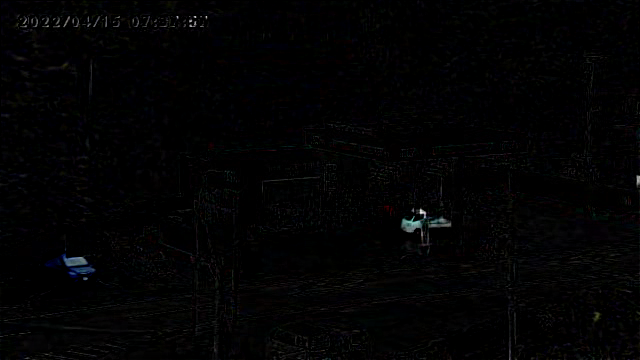

In [185]:
tmp = cv2.subtract(frame, medianFrame)
cv2_imshow(tmp)